<a href="https://colab.research.google.com/github/Ceciliaces/Modelacion-analitica-de-ondas-sismicas/blob/main/Diferencias_Finitas_Solucion_Ec_de_onda_2D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Solución de la ecuación de onda en 2D por el método de diferencias finitas

La ecuación de onda en dos dimensiones es:
<center> $\frac{\partial^2 u}{\partial t^2}=v^2 \left( \frac{\partial ^2 u}{\partial x^2} + \frac{\partial ^2 u}{\partial y^2} \right) $,     t>0, 0 < x $< L_x$, 0 < y $< L_y$ </center>

La solución en una dimensión es una función del tipo f(x-vt) o g(x+vt). A diferecia de la ecuación de calor que es parabólica, la ecuación de onda es hiperbólica.

Las condiciones de frontera de Dirichlet iguales a cero implican una frontera fija y que la onda se refleja invertida. Las condiciones de frontera de Neumann implican una frontera libre y que la onda se refleja sin invertirse.

Para resolverla se utilizan diferencias centradas en tiempo y en espacio.

In [ ]:
import time
import numpy as np
import matplotlib.pylab as plt
import matplotlib.animation as animation
from matplotlib.animation import FuncAnimation
plt.rcParams["animation.html"] = "jshtml"

# Para acceder a las soluciones por diferencias finitas
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Se utiliza el siguiente esquema:
<center> $\frac{u^{n+1}_{i,j} − 2u^{n}_{i,j} + u^{n−1}_{i,j}}{\Delta t ^2} = c^2\left(\frac{u^{n}_{i+1,j} − 2u^{n}_{i,j} + u^{n}_{i−1,j}}{\Delta x^2} + \frac{u^{n}_{i,j+1} − 2u^{n}_{i,j} + u^{n}_{i,j-1}}{\Delta y^2}\right)$ <center>

De ahí se despeja $u^{n+1}_{i,j}$

In [ ]:
def EcOnda_Solver(I, V, f, C, Lx, Ly, Nx, Ny, dt, T, CF):
    t0 = time.time() # Inicia contador

    """
         .+------+
       .' |    .'|
      +---+--+'  |
      |   |  |   |
    u |  ,+--+---+
      |.'    | .' y
      +------+'
         x
    """

    # Dominio espacial
    x = np.linspace(0, Lx, Nx+1)  # Puntos de malla en x
    y = np.linspace(0, Ly, Ny+1)  # Puntos de malla en y
    xv = x[:,np.newaxis]          # Añadimos otra dimensión a los vectores
    yv = y[np.newaxis,:]

    # Dominio temporal
    Nt = int(round(T/float(dt)))  # Puntos de malla en tiempo
    t = np.arange(0,T+dt,dt)

    # Calculamos dx, dy step sizes
    dx = float(Lx/Nx)
    dy = float(Ly/Ny)
    # Se calculan las variables auxiliares
    Cx2 = (C*dt/dx)**2;  Cy2 = (C*dt/dy)**2
    dt2 = dt**2

    # Forzamiento
    if f is None or f == 0:
        f = lambda x, y, t: np.zeros((x.shape[0], y.shape[1]))
    # Condiciones iniciales de velocidad V y posición I
    if V is None or V == 0:
        V = lambda x, y: np.zeros((x.shape[0], y.shape[1]))
    if I is None or I == 0:
        I = lambda x, y: np.zeros((x.shape[0], y.shape[1]))

    # Preasignamos matrices para la solución
    u     = np.zeros((Nx+1,Ny+1))    # Solución
    u_n   = np.zeros((Nx+1,Ny+1))    # Solución en t-dt
    u_nm1 = np.zeros((Nx+1,Ny+1))    # Solución en t-2*dt
    f_a   = np.zeros((Nx+1,Ny+1))    # Forzamiento
    sol   = np.zeros((Nx+1,Ny+1,Nt)) # Arreglo 3D para almacenar u

    # Índices
    It = list(range(0, t.shape[0]))

    # Condiciones iniciales
    u_n[:,:] = I(xv, yv)

    # Primer paso de tiempo
    n = 0
    f_a[:,:] = f(xv, yv, t[n])  # Forzamiento
    V_a = V(xv, yv)             # Velocidad inicial
    u = Esquema(u, u_n, u_nm1, f_a, dx, dt, C, Cx2, Cy2, dt2, CF, Nx, Nz, V=V_a, paso1=True)
    # reescribimos las matrices para el siguiente paso
    u_nm1, u_n, u = u_n, u, u_nm1

    # Resolvemos para los siguientes pasos de tiempo
    for n in It[1:-1]:
        f_a[:,:] = f(xv, yv, t[n])
        u = Esquema(u, u_n, u_nm1, f_a, dx, dt, C, Cx2, Cy2, dt2, CF, Nx, Nz)
        sol[:,:,n] = u
        u_nm1, u_n, u = u_n, u, u_nm1

    t1 = time.time()
    elps = t1 - t0
    print("> Tiempo (s):", elps)
    print("> Tiempo (min):", elps / 60.)

    return x, y, t, sol

# Se define una función para aplicar el esquema de diferencias centradas
def Esquema(u, u_n, u_nm1, f_a, dx, dt, C, Cx2, Cy2, dt2, CF, Nx, Ny, V=None, paso1=False):
    if paso1:
        dt = np.sqrt(dt2)
        Cx2 = 0.5*Cx2;  Cy2 = 0.5*Cy2; dt2 = 0.5*dt2  # redefine
        D1 = 1;  D2 = 0
    else:
        D1 = 2;  D2 = 1

    u_xx = u_n[:-2,1:-1] - 2*u_n[1:-1,1:-1] + u_n[2:,1:-1]
    u_yy = u_n[1:-1,:-2] - 2*u_n[1:-1,1:-1] + u_n[1:-1,2:]

    u[1:-1,1:-1] = D1*u_n[1:-1,1:-1] - D2*u_nm1[1:-1,1:-1] + \
        Cx2[1:-1,1:-1]*u_xx + Cy2[1:-1,1:-1]*u_yy + dt2*f_a[1:-1,1:-1]

    if paso1:
        u[1:-1,1:-1] += dt*V[1:-1, 1:-1] # Se aplica la velocidad inicial

    # Aplicamos condiciones de frontera
    if CF=='D': # Dirichlet
        u[0,:] = 0
        u[:,0] = 0
        u[-1,:]= 0
        u[:,-1]= 0

    if CF=='N': # Neumann
        u[0,:] = u_n[0,:]+2*Cx2[0,:]*(u_n[1,:]-u_n[0,:])
        u[-1,:] = u_n[-1,:]+2*Cy2[-1,:]*(u_n[-2,:]-u_n[-1,:])
        u[:,0] = u_n[:,0]+2*Cx2[:,0]*(u_n[:,1]-u_n[:,0])
        u[:,-1] = u_n[:,-1]+2*Cy2[:,-1]*(u_n[:,-2]-u_n[:,-1])

    if CF=='A': # Absorbentes de primer orden ABC
        # Fronteras superior e inferior
        for j in range(Nx):
            c=C[0,j]
            u[0, j] = u_n[1, j] + (c * dt / dx) * (u_n[0, j] - u[1, j])
            c=C[-1,j]
            u[-1, j] = u_n[-2, j] + (c * dt / dx) * (u_n[-1, j] - u_n[-2, j])

        # Fronteras izquierda y derecha
        for i in range(Ny):
            c=C[i,0]
            u[i, 0] = u_n[i, 1] + (c * dt / dx) * (u_n[i, 0] - u_n[i, 1])
            c=C[i,-1]
            u[i, -1] = u_n[i, -2] + (c * dt / dx) * (u_n[i, -1] - u_n[i, -2])

    if CF=='S': # Condiciones de frontera que simulan el subsuelo, todas absorbentes excepto la frontera superior, que es libre
        # Fronteras superior e inferior
        for j in range(Nx):
            u[0,:] = u_n[0,:]+2*Cx2[0,:]*(u_n[1,:]-u_n[0,:])
            c=C[-1,j]
            u[-1, j] = u_n[-2, j] + (c * dt / dx) * (u_n[-1, j] - u_n[-2, j])

        # Fronteras izquierda y derecha
        for i in range(Ny):
            c=C[i,0]
            u[i, 0] = u_n[i, 1] + (c * dt / dx) * (u_n[i, 0] - u_n[i, 1])
            c=C[i,-1]
            u[i, -1] = u_n[i, -2] + (c * dt / dx) * (u_n[i, -1] - u_n[i, -2])

    return u

In [ ]:
# Dimensiones
Lx = 1
Lz = 1
T = 6 # Tiempo total
dt = 0.012

# Pasos
Nx = 81        # Pasos en x
Nz = 81        # Pasos en y

# Condición inicial de pulso gaussiano
def I(x,z):
    return np.exp(-60*((x-Lx/2)**2+(z-Lz/2)**2))
    #return np.exp(-20*(x-Lx/2)**2-20*(z-Lz/2)**2)

# Velocidad homogénea
v=0.5
C=np.ones((Nx+1,Nz+1))*v

######################################
# Velocidad en capas
#a=8   # Profundidad
#v1=1.5
#v2=3

def VelCapa(a, Nx, Nz, v1, v2):
    s=a*Nz/Lz
    j1=int(s)
    C=np.ones((Nx+1,Nz+1))*v1
    C[:-j1,:]=v2; # C[x][z]
    return C

#C=VelCapa(a,Nx,Nz,v1,v2)

# Barrera física cuadrada en el centro
def VelCuadrado(Nx, Nz, xi, zi, l1, l2, v1, v2):
    j1=int(zi*Nz/Lz)
    j2=int((zi+l2)*Nz/Lz)
    i1=int(xi*Nx/Lx)
    i2=int((xi+l1)*Nx/Lx)
    C=np.ones((Nx+1,Nz+1))*v1
    C[j1:j2,i1:i2]=v2;
    return C

#C=VelCuadrado(Nx,Nz, 7, 7, 6, 6,v1,v2)
######################################

# Solución
x,z,t,u=EcOnda_Solver(I, None, None, C, Lx, Lz, Nx, Nz, dt, T, CF='S')
m,n,h=u.shape
x,z=np.meshgrid(x,z)

> Tiempo (s): 0.5720155239105225
> Tiempo (min): 0.009533592065175374


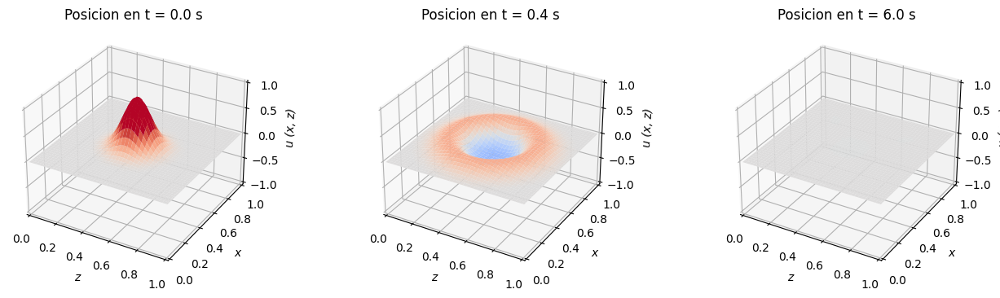

In [ ]:
# Soluciones por DF
fig  = plt.figure(figsize = (16, 4))
# snapshot 1
ax   = fig.add_subplot(1, 3, 1, projection = "3d")
surf = ax.plot_surface(x, z, u[:, :, 1], cmap = "coolwarm", linewidth = 0, vmin = -.5, vmax = .5)
ax.set_xlim(0, Lx)
ax.set_ylim(0, Lz)
ax.set_zlim(-1, 1)
ax.set_xlabel("z", fontstyle = "italic")
ax.set_ylabel("x", fontstyle = "italic")
ax.set_zlabel("u (x, z)", fontstyle = "italic")
ax.set_title(f"Posicion en t = {int(10*t[1])/10} s")
# snapshot 2
n=12
ax   = fig.add_subplot(1, 3, 2, projection = "3d")
surf = ax.plot_surface(x, z, u[:, :, int(h/n)], cmap = "coolwarm", linewidth = 0, vmin = -.5, vmax = .5)
ax.set_xlim(0, Lx)
ax.set_ylim(0, Lz)
ax.set_zlim(-1, 1)
ax.set_xlabel("z", fontstyle = "italic")
ax.set_ylabel("x", fontstyle = "italic")
ax.set_zlabel("u (x, z)", fontstyle = "italic")
ax.set_title(f"Posicion en t = {int(10*t[int(h/n)])/10} s")
# snapshot 3
ax   = fig.add_subplot(1, 3, 3, projection = "3d")
surf = ax.plot_surface(x, z, u[:, :, -1], cmap = "coolwarm", linewidth = 0, vmin = -.5, vmax = .5)
ax.set_xlim(0, Lx)
ax.set_ylim(0, Lz)
ax.set_zlim(-1, 1)
ax.set_xlabel("z", fontstyle = "italic")
ax.set_ylabel("x", fontstyle = "italic")
ax.set_zlabel("u (x, z)", fontstyle = "italic")
ax.set_title(f"Posicion en t = {int(10*t[-1])/10} s")
plt.show()

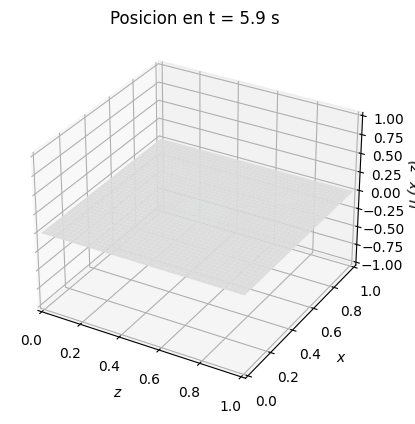

In [ ]:
fig = plt.figure(1)
ax = fig.add_subplot(111, projection='3d')

def animate(i):
    ax.clear()
    ax.plot_surface(x, z, u[:,:,i], cmap = "coolwarm", linewidth = 0, vmin = -.5, vmax = .5)
    ax.set_xlim(0, Lx)
    ax.set_ylim(0, Lz)
    ax.set_zlim(-1, 1)
    ax.set_xlabel("z", fontstyle = "italic")
    ax.set_ylabel("x", fontstyle = "italic")
    ax.set_zlabel("u (x, z)", fontstyle = "italic")
    ax.set_title(f"Posicion en t = {int(10*t[i])/10} s")

anim = FuncAnimation(fig, animate, range(1,len(t)-1), interval=8)
anim.save('Onda 2D Sub Homogeneo.gif')
anim

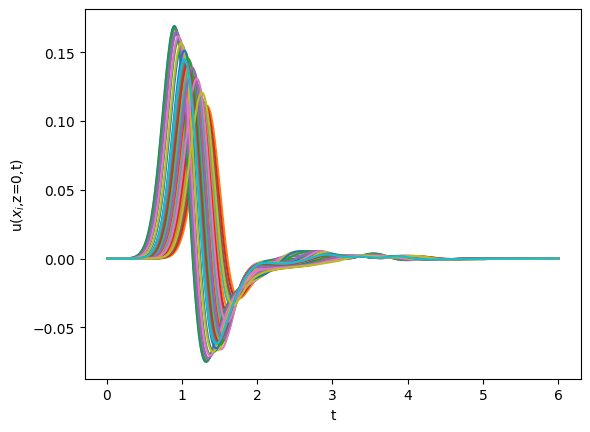

In [ ]:
# Guardar la solución en ciertos n puntos de la superficie
n=20
l=1
for i in range(20):
    T=t.reshape((len(t),1))
    U=[x[0,int((0.025+0.050*i)/(x[0,1]-x[0,0]))]]+list(u[int((0.025+0.050*i)/(x[0,1]-x[0,0])),0,:])
    plt.plot(T[1:],list(u[2+4*i,0,:]), label=f"Sismograma en x={x[int((0.025+0.050*i)/(x[0,1]-x[0,0]))]} km")
    np.savez(f"/content/drive/MyDrive/PINNs - Inversión sismica/Datasets_U_Sism/x_{l}", t=T, u=U)
    plt.plot(T[1:],list(u[0,int(i),:]), label=f"Sismograma en x={x[int(i)]} km")
    plt.xlabel('t')
    plt.ylabel('u($x_i$,z=0,t)')
    l=l+1 # Etiqueta

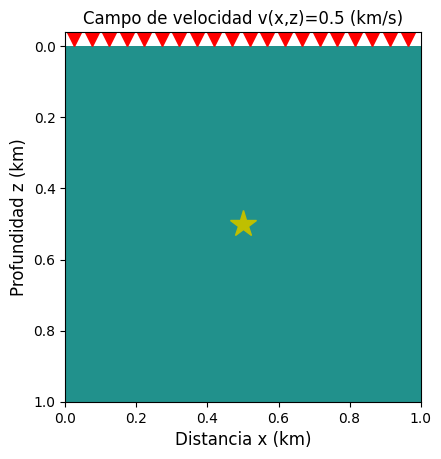

In [ ]:
# Se cargan los datos de los sismogramas
n=20 # Se define la misma n que cuando se generaron los datos
x_sism=[]
u_sism=[]
for i in range(1,n+1):
    data = np.load(f"/content/drive/MyDrive/PINNs - Inversión sismica/Datasets_U_Sism/x_{i}.npz")
    t_sism = data["t"][1:]
    x_sism.append(data["u"][0])
    u_sism.append(data["u"][1:])

v1=0.5
C2=np.ones((Nx+1,Nz+1))*v1

fig5 = plt.figure(9)
ax = fig5.subplots()
cs=ax.contourf(x, z, C2)
plt.plot(x_sism,np.zeros(len(x_sism))-0.02,"rv",markersize=10)
plt.plot(Lz/2,Lx/2,"y*",markersize=20)
ax.set_title('Campo de velocidad v(x,z)=0.5 (km/s)',fontsize=12)
ax.set(xlim=(0, Lx), ylim=(-0.04, Lz))
ax.invert_yaxis()
ax.set_xlabel(r'Distancia x (km)', fontsize=12)
ax.set_ylabel(r'Profundidad z (km)', fontsize=12)
ax.set_aspect('equal', adjustable='box')

plt.savefig('/content/drive/MyDrive/PINNs - Inversión sismica/IMG/Campo vel.png')

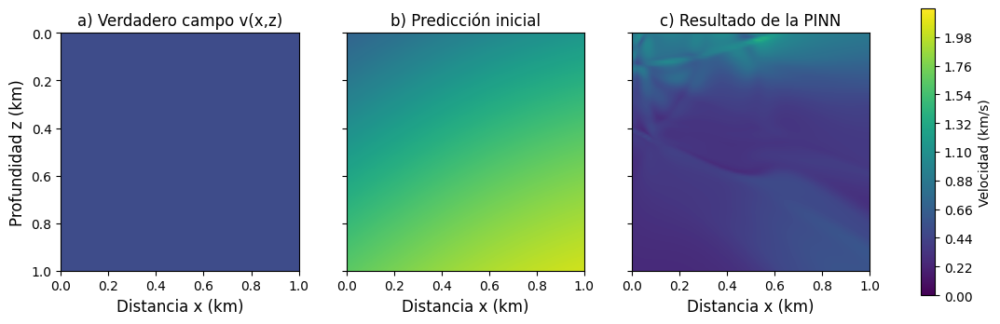

In [ ]:
import tensorflow as tf
## Grafica
x_test = np.linspace(0, 1, 100)
z_test = np.linspace(0, 1, 100)
X, Z = np.meshgrid(x_test, z_test)
data = np.load("/content/drive/MyDrive/PINNs - Inversión sismica/Modelos/v_pred_46000.npz")
v_pred_1 = data["v"]

data = np.load("/content/drive/MyDrive/PINNs - Inversión sismica/Modelos/v_pred_0.npz")
v_pred_0 = data["v"]

# Pasos
Nx = 81        # Pasos en x
Nz = 81        # Pasos en y
v1=0.5
C2=np.ones((Nx+1,Nz+1))*v1
levels = np.linspace(0.0, 2.2, 2000)
# Soluciones por DF
fig, axs = plt.subplots(nrows=1,ncols=3, figsize=(14,4), sharex='col', sharey='row')
(ax1, ax2, ax3)= axs
# snapshot 1
cs1= ax1.contourf(x, z, C2, levels=levels, cmap="viridis")
ax1.invert_yaxis()
ax1.set_xlabel(r'Distancia x (km)', fontsize=12)
ax1.set_ylabel(r'Profundidad z (km)', fontsize=12)
ax1.set_aspect('equal', adjustable='box')
ax1.set_title("a) Verdadero campo v(x,z)")
# snapshot 2
cs2 = ax2.contourf(X, Z, v_pred_0, levels=levels, cmap='viridis')
ax2.invert_yaxis()
ax2.set_xlabel(r'Distancia x (km)', fontsize=12)
ax2.set_aspect('equal', adjustable='box')
ax2.set_title("b) Predicción inicial")
# snapshot 3
cs=ax3.contourf(X, Z, v_pred_1, levels=levels, cmap='viridis')
ax3.invert_yaxis()
ax3.set_xlabel(r'Distancia x (km)', fontsize=12)
ax3.set_aspect('equal', adjustable='box')
ax3.set_title("c) Resultado de la PINN")

plt.colorbar(cs, ax=axs, label='Velocidad (km/s)')
plt.savefig("/content/drive/MyDrive/PINNs - Inversión sismica/IMG/Velocity field")
plt.show()

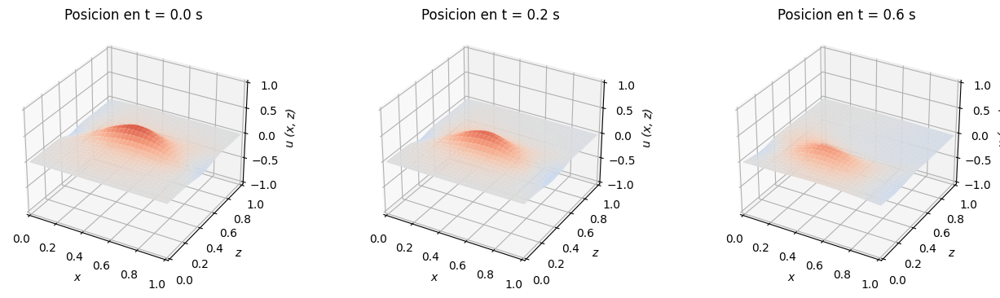

In [ ]:
nelx = 100
nely = 100
timesteps = 101
x = np.linspace(0,1,nelx+1)
y = np.linspace(0,1,nely+1)
t = np.linspace(0,4,timesteps)
delta_t = t[1] - t[0]
xx,yy = np.meshgrid(x,y)

time=0.0
data = np.load(f"/content/drive/MyDrive/PINNs - Inversión sismica/Modelos/u_pred_45000_{time}.npz")
T = data["u"]

fig  = plt.figure(figsize = (16, 4))
# snapshot 1
ax   = fig.add_subplot(1, 3, 1, projection = "3d")
surf = ax.plot_surface(xx, yy, T, cmap = "coolwarm", linewidth = 0, vmin = -.5, vmax = .5)
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)
ax.set_zlim(-1, 1)
ax.set_xlabel("x", fontstyle = "italic")
ax.set_ylabel("z", fontstyle = "italic")
ax.set_zlabel("u (x, z)", fontstyle = "italic")
ax.set_title(f"Posicion en t = {time} s")

# snapshot 2
time=0.2
data = np.load(f"/content/drive/MyDrive/PINNs - Inversión sismica/Modelos/u_pred_45000_{time}.npz")
T = data["u"]

ax   = fig.add_subplot(1, 3, 2, projection = "3d")
surf = ax.plot_surface(xx, yy, T, cmap = "coolwarm", linewidth = 0, vmin = -.5, vmax = .5)
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)
ax.set_zlim(-1, 1)
ax.set_xlabel("x", fontstyle = "italic")
ax.set_ylabel("z", fontstyle = "italic")
ax.set_zlabel("u (x, z)", fontstyle = "italic")
ax.set_title(f"Posicion en t = {time} s")

# snapshot 3
time=0.6
data = np.load(f"/content/drive/MyDrive/PINNs - Inversión sismica/Modelos/u_pred_45000_{time}.npz")
T = data["u"]

ax   = fig.add_subplot(1, 3, 3, projection = "3d")
surf = ax.plot_surface(xx, yy, T, cmap = "coolwarm", linewidth = 0, vmin = -.5, vmax = .5)
ax.set_xlim(0, 1)
ax.set_ylim(0, 1)
ax.set_zlim(-1, 1)
ax.set_xlabel("x", fontstyle = "italic")
ax.set_ylabel("z", fontstyle = "italic")
ax.set_zlabel("u (x, z)", fontstyle = "italic")
ax.set_title(f"Posicion en t = {time} s")
plt.show()

In [ ]:
data4 = np.load("/content/drive/MyDrive/PINNs - Inversión sismica/Terminos funcion de perdida/Terminos_Loss_46000.npz")
data3 = np.load("/content/drive/MyDrive/PINNs - Inversión sismica/Terminos funcion de perdida/Terminos_Loss_39000.npz")
data2 = np.load("/content/drive/MyDrive/PINNs - Inversión sismica/Terminos funcion de perdida/Terminos_Loss_29000.npz")
data1 = np.load("/content/drive/MyDrive/PINNs - Inversión sismica/Terminos funcion de perdida/Terminos_Loss_{epoch}.npz")

In [ ]:
Ic_loss1=data1["Ic_loss"]
Bc_loss1=0.1*data1["Bc_loss"]
Loss_PDE1=0.1*data1["Loss_PDE"]
Loss_sism1=data1["Loss_sism"]
Total_loss1=data1["Total_loss"]

Ic_loss2=data2["Ic_loss"]
Bc_loss2=0.1*data2["Bc_loss"]
Loss_PDE2=0.1*data2["Loss_PDE"]
Loss_sism2=data2["Loss_sism"]
Total_loss2=data2["Total_loss"]

Ic_loss3=data3["Ic_loss"]
Bc_loss3=0.1*data3["Bc_loss"]
Loss_PDE3=0.1*data3["Loss_PDE"]
Loss_sism3=data3["Loss_sism"]
Total_loss3=data3["Total_loss"]

Ic_loss4=data4["Ic_loss"]
Bc_loss4=0.1*data4["Bc_loss"]
Loss_PDE4=0.1*data4["Loss_PDE"]
Loss_sism4=data4["Loss_sism"]
Total_loss4=data4["Total_loss"]

In [ ]:
Ic_loss1=list(Ic_loss1)
Bc_loss1=list(Bc_loss1)
Loss_PDE1=list(Loss_PDE1)
Loss_sism1=list(Loss_sism1)
Total_loss1=list(Total_loss1)

Ic_loss2=list(Ic_loss2)
Bc_loss2=list(Bc_loss2)
Loss_PDE2=list(Loss_PDE2)
Loss_sism2=list(Loss_sism2)
Total_loss2=list(Total_loss2)

Ic_loss3=list(Ic_loss3)
Bc_loss3=list(Bc_loss3)
Loss_PDE3=list(Loss_PDE3)
Loss_sism3=list(Loss_sism3)
Total_loss3=list(Total_loss3)

Ic_loss4=list(Ic_loss4)
Bc_loss4=list(Bc_loss4)
Loss_PDE4=list(Loss_PDE4)
Loss_sism4=list(Loss_sism4)
Total_loss4=list(Total_loss4)

In [ ]:
Ic_loss1.extend(Ic_loss2)
Ic_loss3.extend(Ic_loss4)

Bc_loss1.extend(Bc_loss2)
Bc_loss3.extend(Bc_loss4)

Total_loss1.extend(Total_loss2)
Total_loss3.extend(Total_loss4)

Loss_sism1.extend(Loss_sism2)
Loss_sism3.extend(Loss_sism4)

Loss_PDE1.extend(Loss_PDE2)
Loss_PDE3.extend(Loss_PDE4)

In [ ]:
Ic_loss = Ic_loss1.extend(Ic_loss3)
Bc_loss = Bc_loss1.extend(Bc_loss3)
Total_loss = Total_loss1.extend(Total_loss3)
Loss_PDE = Loss_PDE1.extend(Loss_PDE3)
Loss_sism = Loss_sism1.extend(Loss_sism3)

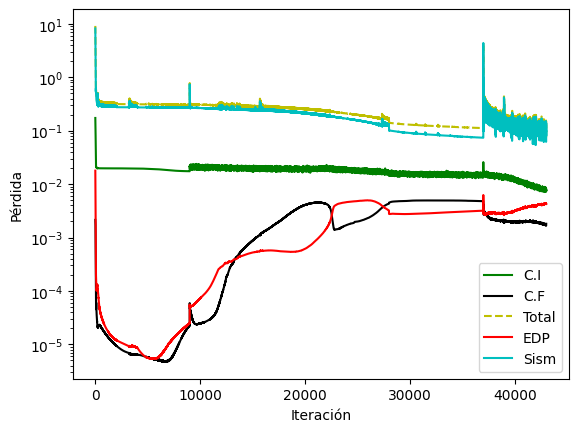

In [ ]:
# Figura de los términos de la función error
fig = plt.figure(1)
plt.plot(Ic_loss1,'g',label='C.I')
plt.plot(Bc_loss1,'black',label='C.F')
plt.plot(Total_loss1,'--y',label='Total')
plt.plot(Loss_PDE1,'r',label='EDP')
plt.plot(Loss_sism1,'c',label='Sism')
plt.yscale("log")
plt.xlabel('Iteración')
plt.ylabel('Pérdida')
plt.legend()
plt.savefig("/content/drive/MyDrive/PINNs - Inversión sismica/IMG/Loss function",dpi=400)
plt.show()

In [ ]:
import tensorflow as tf
loaded = tf.saved_model.load("/content/drive/MyDrive/PINNs - Inversión sismica/Modelos/Model_U_45000", None)
loaded = loaded.signatures["serving_default"]
## load it with same file path
np.array(loaded(xzt_tensor))

array({'output_1': <tf.Tensor: shape=(100, 1), dtype=float32, numpy=
array([[ 3.8322585e-04],
       [ 9.1340917e-04],
       [ 1.1246480e-03],
       [ 1.0138430e-03],
       [ 6.2048214e-04],
       [ 4.3300563e-05],
       [-5.3052825e-04],
       [-7.9606695e-04],
       [-3.7271006e-04],
       [ 7.8953581e-04],
       [ 1.3962142e-03],
       [-6.2277762e-04],
       [-3.4784363e-03],
       [-1.2729190e-03],
       [ 1.0118404e-02],
       [ 3.0942755e-02],
       [ 5.8231454e-02],
       [ 8.6691245e-02],
       [ 1.1047288e-01],
       [ 1.2485877e-01],
       [ 1.2631533e-01],
       [ 1.1178137e-01],
       [ 8.0549315e-02],
       [ 3.9560433e-02],
       [ 2.3734695e-03],
       [-2.1775978e-02],
       [-3.2694448e-02],
       [-3.4617875e-02],
       [-3.1798664e-02],
       [-2.7102696e-02],
       [-2.2117527e-02],
       [-1.7589377e-02],
       [-1.3789462e-02],
       [-1.0749998e-02],
       [-8.3961058e-03],
       [-6.6171908e-03],
       [-5.3001218e-03],
      

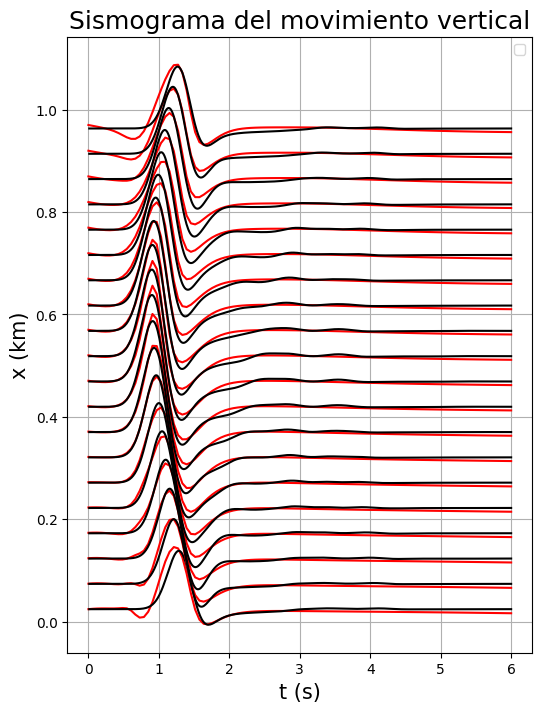

In [ ]:
def plot_pinn_prediction(model, x_0, i,  z_0, t_max):
    """
    Grafica la predicción de la PINN para una coordenada espacial dada u(x_0, z_0, t).
    hasta el tiempo t_max

    Args:
        model: Trained PINN model.
        x_0: Valores de x_sism (posiciones de los receptores)
        i: Selección de uno de los receptores
        z_0: Fixed value of z.
        t_max: The maximum time (in seconds) to evaluate the solution (e.g., 6 seconds).
    """

    # Se crea un arreglo de puntos desde 0 hasta t_max
    t_values = np.linspace(0, t_max, 100)  # 100 time points from 0 to t_max

    # Se crean arreglos de igual tamaño para x y z
    x = np.full_like(t_values, x_0[i])  # x fija en x_0
    z = np.full_like(t_values, z_0)  # z fija en z_0

    # Se juntan y convierten en un tensor para el modelo
    xzt = np.vstack((x, z, t_values)).T
    xzt_tensor = tf.convert_to_tensor(xzt, dtype=tf.float32)

    # Se realiza la predicción
    u_predictions = model(xzt_tensor)
    result = u_predictions.items()

    # Convertir a una lista
    data = list(result)

    # Convertir la lista en un array
    numpyArray = np.array(data[0][1])

    # Se grafica la predicción junto al sismograma
    plt.plot(t_values, numpyArray+np.full_like(numpyArray, x_0[i]),"r-")
    plt.plot(t_sism,u_sism[i]+np.full_like(u_sism[i], x_0[i]),"k-")


# Ejemplo
fig = plt.figure(figsize=(6, 8))
plt.xlabel('t (s)', fontsize=15)
plt.ylabel('x (km)', fontsize=15)
plt.title("Sismograma del movimiento vertical", fontsize=18)
plt.legend()
plt.grid(True)
n=20
for i in range(n):
  plot_pinn_prediction(loaded, x_0=x_sism, i=i, z_0=0.0, t_max=6)

plt.savefig("/content/drive/MyDrive/PINNs - Inversión sismica/IMG/Preassure field")
plt.show()